# <p><center style="font-family:newtimeroman;font-size:180%;"> Plant Village Disease Classification </center></p>
### Table of contents:

* [Import Libraries](#1)
* [Read Data](#2)
* [Visualization Of Dataset](#3)
* [Data Augmentation](#4)
* [Train Xception Model](#5)
* [Evaluate The Model](#6)

**<a id="1"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px">Import Libraries </p>
<a class="btn" href="#home">Tabel of Contents</a>

In [1]:
import os 
import cv2
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import keras 
from keras.callbacks import EarlyStopping,ModelCheckpoint
import tensorflow as tf
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from tqdm import tqdm

**<a id="2"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px">Read Data </p>
<a class="btn" href="#home">Tabel of Contents</a>

In [2]:
def data(dataset_path):
    images = []
    labels = []
    for subfolder in tqdm(os.listdir(dataset_path)):
        subfolder_path = os.path.join(dataset_path, subfolder)
        for image_filename in os.listdir(subfolder_path):
            image_path = os.path.join(subfolder_path, image_filename)
            images.append(image_path)
            labels.append(subfolder)
    df = pd.DataFrame({'image': images, 'label': labels})
    return df

In [3]:
#train
train = data('/kaggle/input/plantvillage-dataset/color')
train.head()

100%|██████████| 38/38 [00:04<00:00,  8.55it/s]


,image,label
0,/kaggle/input/plantvillage-dataset/color/Tomat...,Tomato___Late_blight
1,/kaggle/input/plantvillage-dataset/color/Tomat...,Tomato___Late_blight
2,/kaggle/input/plantvillage-dataset/color/Tomat...,Tomato___Late_blight
3,/kaggle/input/plantvillage-dataset/color/Tomat...,Tomato___Late_blight
4,/kaggle/input/plantvillage-dataset/color/Tomat...,Tomato___Late_blight


In [4]:
train.shape

(54305, 2)

**<a id="3"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px">Visualization of Dataset </p>
<a class="btn" href="#home">Tabel of Contents</a>

In [5]:
train.label.value_counts().to_frame()

,count
label,
Orange___Haunglongbing_(Citrus_greening),5507
Tomato___Tomato_Yellow_Leaf_Curl_Virus,5357
Soybean___healthy,5090
Peach___Bacterial_spot,2297
Tomato___Bacterial_spot,2127
Tomato___Late_blight,1909
Squash___Powdery_mildew,1835
Tomato___Septoria_leaf_spot,1771
Tomato___Spider_mites Two-spotted_spider_mite,1676


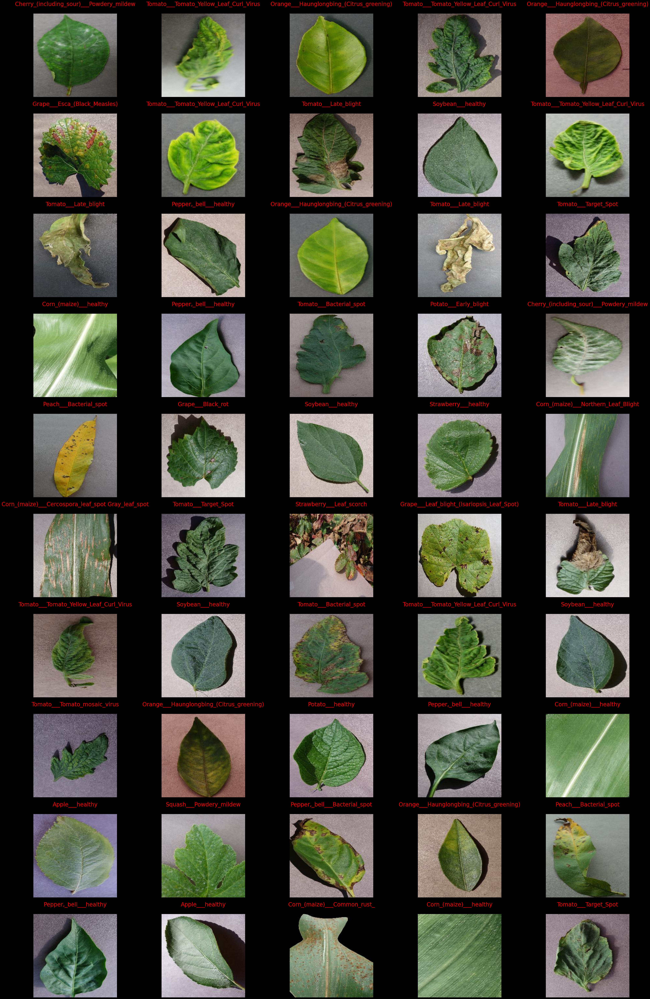

In [6]:
plt.style.use('dark_background')
plt.figure(figsize=(50,80))
for n,i in enumerate(np.random.randint(0,len(train),50)):
    plt.subplot(10,5,n+1)
    img = cv2.imread(train.image[i])
    img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.axis('off')
    text = f'{train.label[i]}\n'
    plt.title(text,color= 'red',fontsize=25)

<a id="4"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px"> Data Augmentation </p>
<a class="btn" href="#home">Tabel of Contents</a>

In [7]:
X_train, X_test1, y_train, y_test1 = train_test_split(train['image'], train['label'], test_size=0.2, random_state=42,shuffle=True)
X_val, X_test, y_val, y_test = train_test_split(X_test1,y_test1, test_size=0.5, random_state=42,shuffle=True)
df_train = pd.DataFrame({'image': X_train, 'label': y_train})
df_test = pd.DataFrame({'image': X_test, 'label': y_test})
df_val = pd.DataFrame({'image': X_val, 'label': y_val})

In [8]:
image_size = (224, 224)
batch_size = 32
datagen = ImageDataGenerator(
    rescale=1./255
)
train_datagen = ImageDataGenerator(
    rescale=1./255, 
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)
train_generator = train_datagen.flow_from_dataframe(
    df_train,
    x_col='image',
    y_col='label',
    target_size=image_size,
    batch_size=batch_size,
    shuffle=True
)
test_generator = datagen.flow_from_dataframe(
    df_test,
    x_col='image',
    y_col='label',
    target_size=image_size,
    batch_size=batch_size,
    shuffle=False
)
val_generator = datagen.flow_from_dataframe(
    df_val,
    x_col='image',
    y_col='label',
    target_size=image_size,
    batch_size=batch_size,
    shuffle=False
)

Found 43444 validated image filenames belonging to 38 classes.
Found 5431 validated image filenames belonging to 38 classes.
Found 5430 validated image filenames belonging to 38 classes.


In [9]:
class_ = test_generator.class_indices.keys()
class_ = list(class_)

<a id="5"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px"> Modeling </p>
<a class="btn" href="#home">Tabel of Contents</a>

In [10]:
base_model = tf.keras.applications.xception.Xception(weights= 'imagenet' ,include_top = False , input_shape = (224,224,3) ,
                                                     pooling = 'max' )
model = keras.models.Sequential([
    base_model,
    keras.layers.BatchNormalization(),
    keras.layers.Dense(256,activation = 'relu'),
    keras.layers.Dropout(.5),
    keras.layers.Dense(38 , activation= 'softmax' )
])
model.summary()

83683744/83683744 ━━━━━━━━━━━━━━━━━━━━ 4s 0us/step


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ xception (Functional)           │ ?                      │    20,861,480 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ ?                      │   0 (unbuilt) │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ ?                      │   0 (unbuilt) │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ ?                      │   0 (unbuilt) │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ ?                      │   0 (unbuilt) │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 20,861,480 (79.58 MB)

 Trainable params: 20,806,952 (79.37 MB)

 Non-trainable params: 54,528 (213.00 KB)

In [11]:
checkpoint_cb =ModelCheckpoint("my_keras_model.keras", save_best_only=True)
early_stopping_cb =EarlyStopping(patience=5, restore_best_weights=True)
model.compile(optimizer ='adam', loss='categorical_crossentropy', metrics=['accuracy',keras.metrics.AUC()])
hist=model.fit(train_generator,epochs=5,validation_data=val_generator,callbacks=[checkpoint_cb,early_stopping_cb])

Epoch 1/5


/opt/conda/lib/python3.10/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
I0000 00:00:1728431105.607491      70 service.cc:145] XLA service 0x7cab2c02eef0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1728431105.607540      70 service.cc:153]   StreamExecutor device (0): Tesla P100-PCIE-16GB, Compute Capability 6.0
I0000 00:00:1728431132.875646      70 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


1358/1358 ━━━━━━━━━━━━━━━━━━━━ 774s 530ms/step - accuracy: 0.7541 - auc: 0.9613 - loss: 1.0218 - val_accuracy: 0.9517 - val_auc: 0.9970 - val_loss: 0.1649
Epoch 2/5
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 519s 380ms/step - accuracy: 0.9266 - auc: 0.9937 - loss: 0.2800 - val_accuracy: 0.2595 - val_auc: 0.6671 - val_loss: 17.8389
Epoch 3/5
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 514s 376ms/step - accuracy: 0.9303 - auc: 0.9937 - loss: 0.2745 - val_accuracy: 0.9006 - val_auc: 0.9807 - val_loss: 0.5502
Epoch 4/5
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 511s 374ms/step - accuracy: 0.9459 - auc: 0.9955 - loss: 0.2018 - val_accuracy: 0.8746 - val_auc: 0.9722 - val_loss: 0.8067
Epoch 5/5
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 511s 374ms/step - accuracy: 0.9480 - auc: 0.9955 - loss: 0.2061 - val_accuracy: 0.9656 - val_auc: 0.9955 - val_loss: 0.1541


<a id="6"></a>
# <p style="background-image: url(https://i.postimg.cc/K87ByXmr/stage5.jpg);font-family:camtasia;font-size:120%;color:white;text-align:center;border-radius:15px 50px; padding:7px"> Evaluate The Model  </p>
<a class="btn" href="#home">Tabel of Contents</a>

In [12]:
hist_=pd.DataFrame(hist.history)
hist_

,accuracy,auc,loss,val_accuracy,val_auc,val_loss
0,0.843431,0.983106,0.618968,0.951750,0.996964,0.164902
1,0.926342,0.993455,0.283642,0.259484,0.667113,17.838915
2,0.939232,0.994831,0.236483,0.900553,0.980731,0.550192
3,0.947335,0.995777,0.196020,0.874586,0.972158,0.806676
4,0.950327,0.995751,0.191978,0.965562,0.995489,0.154131


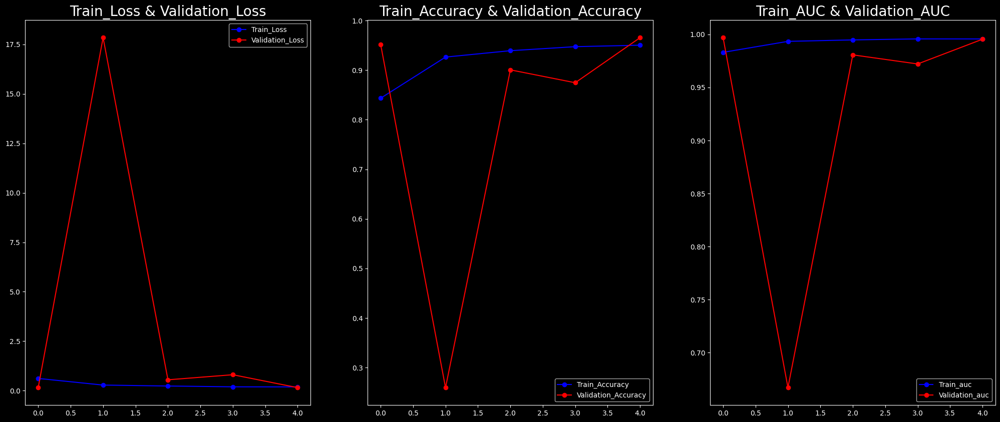

In [13]:
plt.figure(figsize=(25,10))
plt.subplot(1,3,1)
plt.plot(hist_['loss'],'b-o',label='Train_Loss')
plt.plot(hist_['val_loss'],'r-o',label='Validation_Loss')
plt.title('Train_Loss & Validation_Loss',fontsize=20)
plt.legend()
plt.subplot(1,3,2)
plt.plot(hist_['accuracy'],'b-o',label='Train_Accuracy')
plt.plot(hist_['val_accuracy'],'r-o',label='Validation_Accuracy')
plt.title('Train_Accuracy & Validation_Accuracy',fontsize=20)
plt.legend()
plt.subplot(1,3,3)
plt.plot(hist_.iloc[:,1],'b-o',label='Train_auc')
plt.plot(hist_.iloc[:,4],'r-o',label='Validation_auc')
plt.title('Train_AUC & Validation_AUC',fontsize=20)
plt.legend()
plt.show()

In [14]:
score, acc,auc = model.evaluate(test_generator)
print('Test Loss =', score)
print('Test Accuracy =', acc)
print('Test AUC =', auc)

  1/170 ━━━━━━━━━━━━━━━━━━━━ 28s 167ms/step - accuracy: 0.9688 - auc: 0.9998 - loss: 0.1146

/opt/conda/lib/python3.10/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


170/170 ━━━━━━━━━━━━━━━━━━━━ 37s 218ms/step - accuracy: 0.9651 - auc: 0.9955 - loss: 0.1587
Test Loss = 0.15906107425689697
Test Accuracy = 0.9663045406341553
Test AUC = 0.995570719242096


In [15]:
# Get true labels
y_test = test_generator.classes
# Predict probabilities for each class
predictions = model.predict(test_generator)
# Convert predicted probabilities to class labels (choose the class with the highest probability)
y_pred = np.argmax(predictions, axis=1)
# Flatten both arrays just in case
y_test = np.ravel(y_test)
y_pred = np.ravel(y_pred)
# Create a DataFrame to compare actual vs predicted labels
df = pd.DataFrame({'Actual': y_test, 'Prediction': y_pred})
# Display the DataFrame
df.head()  # Show the first few rows of the comparison

170/170 ━━━━━━━━━━━━━━━━━━━━ 15s 77ms/step


,Actual,Prediction
0,24,24
1,15,15
2,19,19
3,15,15
4,8,8


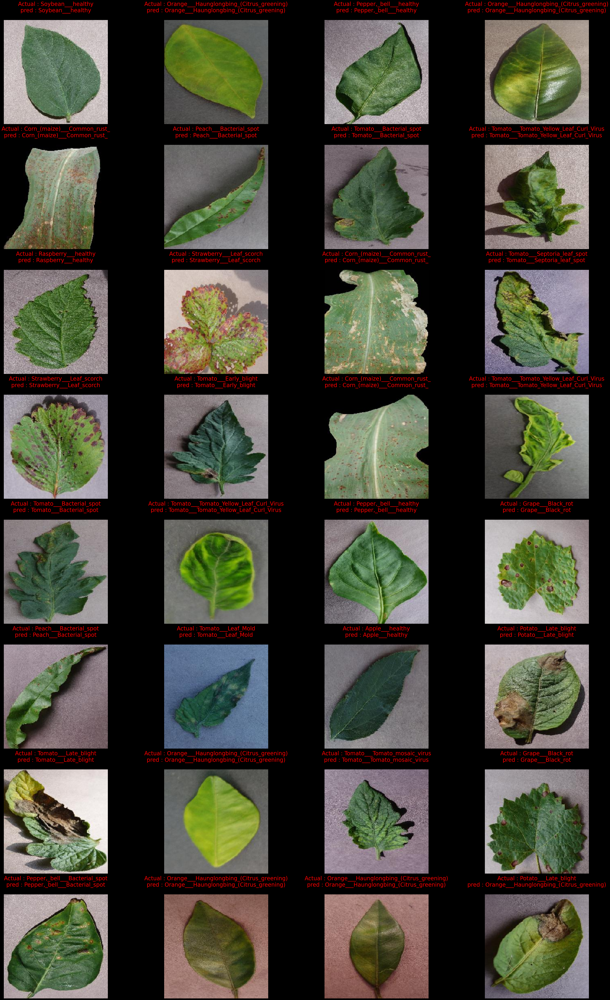

In [16]:
batch = next(test_generator)
images= batch[0]
plt.figure(figsize=(50,80))
for n in range(32):
    plt.subplot(8,4,n+1)
    plt.imshow(images[n])
    plt.axis('off')
    text = f'Actual : {class_[int(y_test[n])]}\npred : {class_[int(y_pred[n])]}\n'
    plt.title(text,color= 'red',fontsize=25)

array([[ 49,   5,   0, ...,   0,   0,   0],
       [  0,  56,   0, ...,   0,   0,   0],
       [  0,   0,  21, ...,   0,   0,   0],
       ...,
       [  0,   0,   0, ..., 532,   0,   0],
       [  0,   0,   0, ...,   0,  33,   0],
       [  0,   0,   0, ...,   0,   0, 159]])

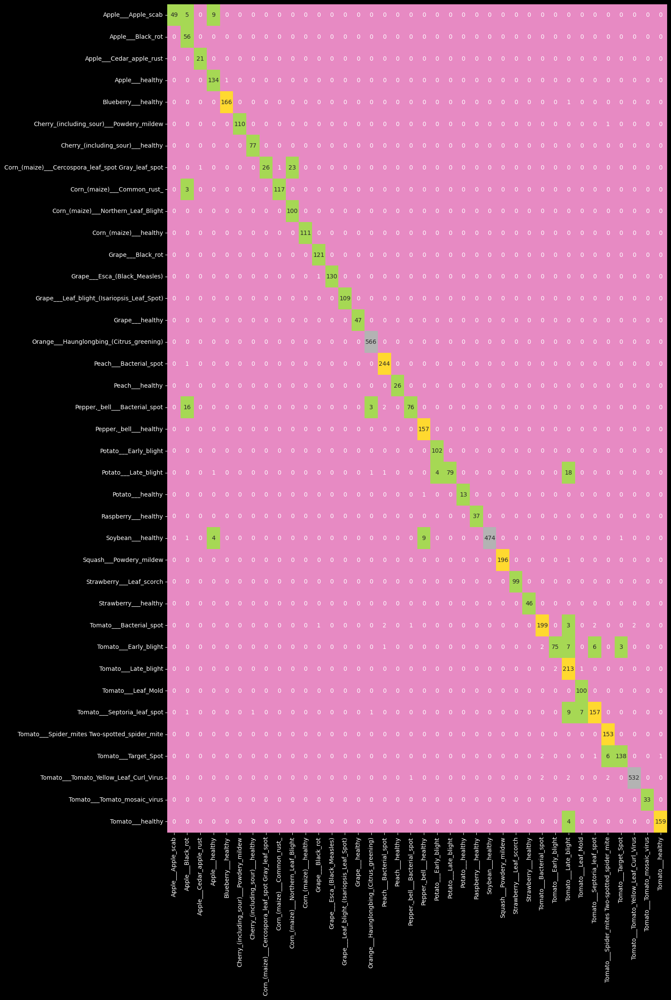

In [17]:
CM = confusion_matrix(y_test,y_pred)
plt.figure(figsize=(15,25))
sns.heatmap(CM,fmt='g',center = True,cbar=False,annot=True,cmap='Set2',xticklabels=class_,yticklabels=class_)
CM

In [18]:
ClassificationReport = classification_report(y_test,y_pred,target_names=class_)
print('Classification Report is : ', ClassificationReport)

Classification Report is :                                                      precision    recall  f1-score   support

                                Apple___Apple_scab       1.00      0.78      0.88        63
                                 Apple___Black_rot       0.67      1.00      0.81        56
                          Apple___Cedar_apple_rust       0.95      1.00      0.98        21
                                   Apple___healthy       0.91      0.99      0.95       135
                               Blueberry___healthy       0.99      0.99      0.99       167
          Cherry_(including_sour)___Powdery_mildew       1.00      0.99      1.00       111
                 Cherry_(including_sour)___healthy       0.99      1.00      0.99        77
Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot       1.00      0.51      0.68        51
                       Corn_(maize)___Common_rust_       0.99      0.97      0.98       120
               Corn_(maize)___Northern_Leaf_Blight 